# Acelerador de particulas de tipo ciclotrón.





Conocimientos necesarios para entender su funcionamiento

$\textbf{Fuerza de lorentz:}$

Si tanto un campo eléctrico $\textbf{E}$ como un campo magnético $\textbf{B}$ actuán sobre una partícula cargada, la fuerza total sobre ellas puede expresarse como
$$\textbf{F}=q\textbf{E} + qv\times \textbf{B}$$
$\textbf{Cargas circulantes:}$

Sea un haz de electrones que viaja a través de una cámara al vacío en la que existe un campo magnético uniforme $\textbf{B}$ fuera del plano de la figura.La fuerza magnética deflectora es la única fuerza importante.

La fuerza magnética tiene 2 propiedades:

-no cambia la velocidad de las partículas

-siempre actúa perpendicularmente a la velocidad de las partículas

Esto claramente describe una movimiento circular



Puesto que $\textbf{B}$ es perpendicular a v, la magnitud de la fuerza magnética puede escribirse qv$\textbf{B}$, y la segunda ley de Newton da,
$$qv\textbf{B} = m\frac{v^2}{r}$$
o sea
$$r=\frac{mv}{q\textbf{B}}=\frac{p}{q\textbf{B}} \Rightarrow p=q\textbf{B}r$$ 
Esta ecuación es conocida como ciclotrón fórmula. 

La velocidad angular del moviento circular es
$$\omega = \frac{v}{r} = \frac{q\textbf{B}}{m}$$
y la frecuencia correspondiente es
$$\nu = \frac{\omega}{2\pi} = \frac{q\textbf{B}}{2\pi m}$$
Notese que la frecuencia asociada con el movimiento circular no depende de la velocidad de la partícula(siempre que $v\ll c$).
A esta frecuencia se le llama frecuencia del ciclotrón, porque las partículas circulan a esta fecuencia en un ciclotrón.

Una trayectoría más exótica ocurre si incluimos un campo eléctrico uniforme, perpendicular al campo magnético.

supón que $\textbf{B}$ apunta en la dirección x, y $\textbf{E}$ en la dirección z.
Una carga positiva se deja en el origen, veremos que camino sigue.

Primero importamos las librería necesarias.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
%matplotlib notebook

Después definimos la figura, la cual llamaremos graf y definimos el plano que tendra una proyección en 3d.



<IPython.core.display.Javascript object>


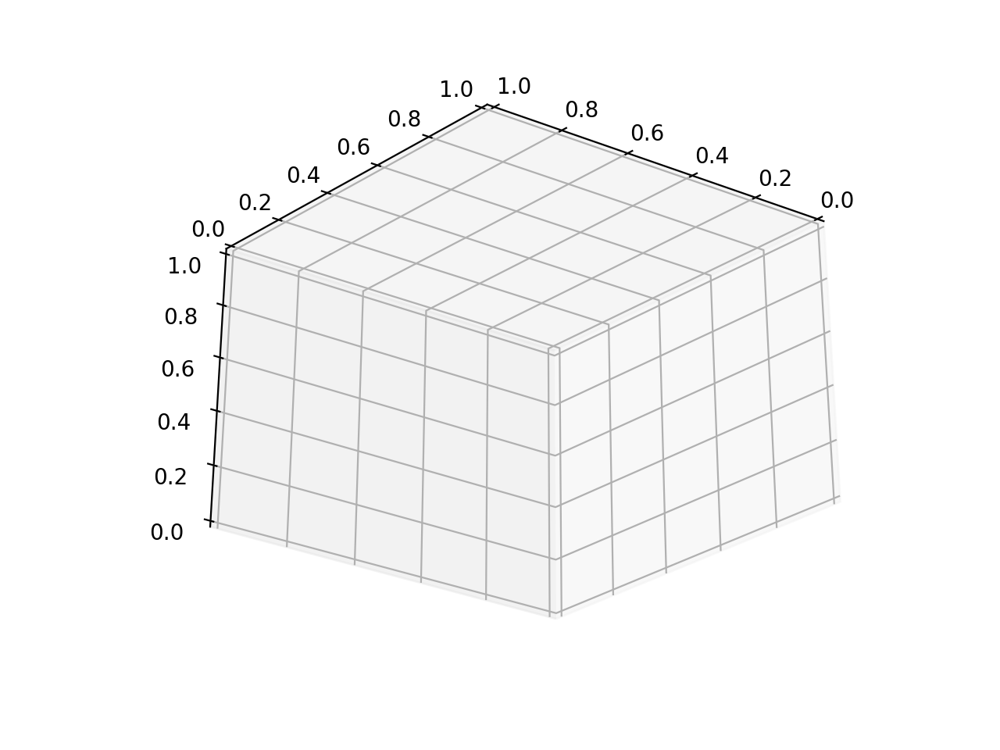

In [4]:
%matplotlib notebook

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d

graf = plt.figure()
plano = graf.add_subplot(111, projection='3d')
plt.show()

Para hacer que el tiempo fluya usaremos iteraciones usando la biblioteca numpy,a su vez declaramos nuestras contantes iniciales que seran el campo electrico, el campo magnetico,la velocidad angular y el tiempo total.

In [5]:
iters = 100
rmax = 10
dr = rmax /iters
r = np.arange(0,rmax+dr,dr)

E=4
B=5
W=3
vz=2
Tt=40

dt = Tt / iters
t = np.arange(0, Tt+dt, dt)

Ahora si iniciamos la parte matematica, las matematicas que se usaran son matematicas un tanto básicas ya que yo apenas pase a segundo semestre de física por lo tanto creo sea fácil de entender para el lector.

$$v = (0,\dot{y},\dot{z})$$
entonces
$$v \times \textbf{B} =\begin{vmatrix} 
\hat{x} & \hat{y} & \hat{z} \\ 
0 & \dot{y} & \dot{z} \\ 
B & 0 & 0  
\end{vmatrix} = \textbf{B}\dot{z}\hat{y}-\textbf{B}\dot{y}\hat{z}$$

y aplicando la segunda ley de Newton,
$$\textbf{F}=Q(\textbf{E}+v \times \textbf{B})=Q(E\hat{z}+B\dot{z}\hat{y}-B\dot{y}\hat{z})=m\textbf{a}=m(\ddot{y}\hat{y}+\ddot{z}\hat{z})$$

tomando los componentes $\hat{y}$ y $\hat{z}$ separadamente,
$$QB\dot{z}=m\ddot{y} , QE-QB\dot{y}=m\ddot{z}$$
Y como sabemos
$$\omega=\frac{QB}{m}$$
Entonces las ecuaciones de movimiento toman la forma
$$\ddot{y}=\omega\dot{z} , \ddot{z}=\omega(\frac{E}{B}-\dot{y})$$

$$\frac{\dddot{y}}{\omega}=\omega(\frac{E}{B}-\dot{y})\Rightarrow \dddot{y}=\omega^2(\frac{E}{B}-\dot{y})$$
$$\Rightarrow \dddot{y}+\omega^2\dot{y}=\omega^2\frac{E}{B}$$
Y usando teoremas de ecuaciones diferenciales trivialmente se resuma a esto ,
$$\ddot{y}+\omega^2y=0$$
Y esto es un oscilador armonico, por lo tanto

$$y(t)=C_1 cos\omega t + C_2 sin\omega t + \frac{E}{B}t + C_3$$
$$z(t)=C_2 cos\omega t - C_1 sin\omega t + C_4$$
Pero la particula inició desde el reposo($\dot{y}(0)=\dot{z}(0)=0$),en el origen($y(0)=z(0)=0$);Estas 4 condiciones determinan las constantes $C_1,C_2,C_3,C_4$\\
$$y(t)=\frac{E}{\omega B}(\omega t-sin\omega t),  z(t)=\frac{E}{\omega B}(1-cos\omega t)$$

Por otro lado como $R=\frac{E}{\omega B}$
y si eliminamos los senos y cosenos usando la identidad trigonometrica  $$sin^2\omega t + cos^2\omega t=1$$
Encontramos,
$$(y-R\omega t)^2 + (z-R)^2=R^2$$
Esta es la fórmula de un circulo de radio R, con centro en $(0,R\omega t,R)$ que se mueve en la dirección y con una velocidad constante
$$u=\omega R = \frac{E}{B}$$
Por lo tanto la particula se mueve como si fuera una llanta rodando por el eje y.


In [9]:
x = (E/(W*B))*(1-np.cos(W*t))
y = (E/(W*B))*(W*t-np.sin(W*t))
z = vz * t
z2 = np.array([z,z])
plano.plot_wireframe(x, y, z2)

plano.set_xlabel('x')
plano.set_ylabel('y')
plano.set_zlabel('z')

Text(0.09379629152477453, 0.012566320283548621, 'z')

en jupyter creo nose puede pero en las demás plataformas si.

Ahora que entendemos más como funcionan las fuerzas electromagnticas procederemos a simular el ciclotrón.
El ciclotrón consta de dos placas semicirculares huecas, que se montan con sus bordes diametrales adyacentes dentro de un campo magnético uniforme que es normal al plano de las placas y se hace el vacío. A dichas placas se le aplican oscilaciones de alta frecuencia que producen un campo eléctrico oscilante en la región diametral entre ambas.
Como consecuencia, durante un semiciclo el campo eléctrico acelera los iones, formados en la región diametral, hacia el interior de uno de los electrodos, llamados 'Ds', donde se les obliga a recorrer una trayectoria circular mediante un campo magnético y finalmente, aparecerán de nuevo en la región intermedia.
El campo
magnético se ajusta de modo que el tiempo que se necesita para recorrer la trayectoria semicircular dentro del electrodo sea igual al semiperiodo de las oscilaciones. En consecuencia, cuando los iones vuelven a la región intermedia, el campo eléctrico habrá invertido su sentido y los iones recibirán entonces un segundo aumento de la velocidad al pasar al interior de la otra 'D'.


Como los radios de las trayectorias son proporcionales a las velocidades de los iones, el tiempoque se necesita para el recorrido de una trayectoria semicircular es independiente de sus velocidades. Por consiguiente, si los iones emplean exactamente medio ciclo en una primera semicircunferencia, se comportarán de modo análogo en todas las sucesivas y, por tanto, se moverán en espiral y en resonancia con el campo oscilante hasta que alcancen la periferia del aparato.

Su energía cinética final, será tantas veces mayor que la que corresponde al voltaje aplicado a los electrodos multiplicado por el número de veces que el ión ha pasado por la región intermedia entre las 'Ds'.

Por lo tanto usaremos las matématicas del moviento circular y la fuerza de lorentz para hacer una simulación.

In [13]:
from IPython.display import HTML

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in double_scalars
Animation size has reached 21011548 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


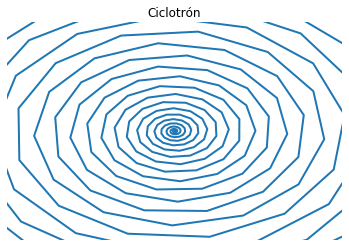

In [14]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np


fig = plt.figure()
ax = plt.axes(xlim=(-2*(10**10),2*(10**10) ), ylim=(-2*(10**10), 2*(10**10)))
line, = ax.plot([], [], lw=2)
q=1.6/(10**19)#Carga protón
B=0.000003#campo magnetico
V=5#voltaje de las D´s
m=1.6726/(10**27)#masa del proton
r=0.01#distancia entre las D´s
a=(V*q)/(m*r)#aceleracion generada por las D´s
t=(np.pi*m)/(q*B)#PERIODO PARA QUE LA D´cambien
Tt=20#tiempo total que desemos de recorrido
# initialization function
def init():
    
    line.set_data([], [])
    return line,


xdata, ydata = [], []


def animate(i):
    
    T = 0.1*i
    
    
    r=T/t#numero de D en la que esta
    n=np.floor(r)
    v=(n*V*q*T)/(m*r) + (2*n**3 -3*n**2+n)*(V*q*t)/(6*m*r)
    y=(m*v*np.sin(np.deg2rad((q*B*T)/m)))/(q*B)
    x=(m*v*np.cos(np.deg2rad((q*B*T)/m)))/(q*B)
    
    
    xdata.append(x)
    ydata.append(y)
    
    
    line.set_data(xdata, ydata)
    
  
    return line,
    

plt.title('Ciclotrón')

plt.axis('off')

    
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=500, interval=20, blit=True)



HTML(anim.to_jshtml())